# Schwarmverhalten


## Ungefähr gleiche Bewegung des Nachbarn

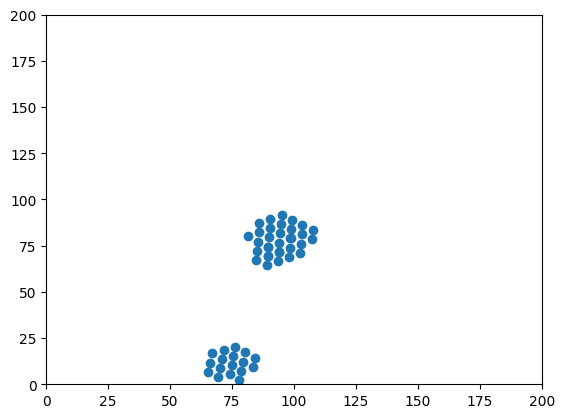

In [24]:



import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display
import random

# Parameter

anzahl_Voegel = 50
dt=0.05

# Initialisierung der Positionen und Geschwindigkeiten
positionen = np.random.rand(anzahl_Voegel, 2) * 100
geschwindigkeiten = (np.random.rand(anzahl_Voegel, 2) - 0.5) * 10   
# Schwarmverhalten Regeln
def aktualisiere_geschwindigkeiten(positionen, geschwindigkeiten):
    neue_geschwindigkeiten = geschwindigkeiten.copy()
    for i in range(anzahl_Voegel):
        nachbarn = []
        for j in range(anzahl_Voegel):
            if i != j and np.linalg.norm(positionen[i] - positionen[j]) < 20:
                nachbarn.append(j)
        
        if nachbarn:
            # Regel 1: Zusammenhalt
            mittelpunkt = np.mean(positionen[nachbarn], axis=0)
            richtung_zum_mittelpunkt = mittelpunkt - positionen[i]
            neue_geschwindigkeiten[i] += richtung_zum_mittelpunkt * 0.01
            
            # Regel 2: Abstand halten
            for j in nachbarn:
                abstand = positionen[i] - positionen[j]
                if np.linalg.norm(abstand) < 5:
                    neue_geschwindigkeiten[i] += abstand * 0.05
            
            # Regel 3: Gleiche Bewegung
            durchschnitts_geschwindigkeit = np.mean(geschwindigkeiten[nachbarn], axis=0)
            neue_geschwindigkeiten[i] += (durchschnitts_geschwindigkeit - geschwindigkeiten[i]) * 0.05
            
    return neue_geschwindigkeiten
# Simulation
def update(frame):
    global positionen, geschwindigkeiten
    geschwindigkeiten = aktualisiere_geschwindigkeiten(positionen, geschwindigkeiten)
    positionen += geschwindigkeiten * dt
    scat.set_offsets(positionen)
    return scat,

fig, ax = plt.subplots()
scat = ax.scatter(positionen[:,0], positionen[:,1])
ax.set_xlim(0, 200)
ax.set_ylim(0, 200)
ani = FuncAnimation(fig, update, frames=1000, interval=50)
# Animation im Notebook anzeigen; benutze JS-HTML mit Fallback auf HTML5-Video
try:
    display(HTML(ani.to_jshtml()))
except Exception as e:
    display(HTML(ani.to_html5_video()))

